In [1]:
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from transformers import SamProcessor
from transformers import SamModel 
import torch
import os



/home/zekunl/.conda/envs/criticalmaas/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

In [3]:

model = SamModel.from_pretrained("facebook/sam-vit-base")
model.to(device)

model.load_state_dict(torch.load('checkpoints/ep1.pth'))


model.eval()

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

In [4]:
# # get box prompt based on ground truth segmentation map
# ground_truth_mask = np.array(dataset[idx]["label"])
# prompt = get_bounding_box(ground_truth_mask)

def test_model(img_path, model, processor):
    
    # img_path = '../data/data_crop1024_shift512/test_images/Greenland26X_22W_Sentinel2_2019-07-31_25_r4__h4_w2.jpg' # h3_w5 # h3_w6
    image = Image.open(img_path)
    
    prompt = [[[0,0,1024,1024]]]
    
    # prepare image + box prompt for the model
    inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)
    # for k,v in inputs.items():
    #   print(k,v.shape)

    # forward pass
    with torch.no_grad():
        outputs = model(**inputs, multimask_output=False)

    # apply sigmoid
    lake_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
    # convert soft mask to hard mask
    lake_seg_prob = lake_seg_prob.cpu().numpy().squeeze()
    lake_seg = (lake_seg_prob > 0.5).astype(np.uint8)

    return lake_seg

In [17]:
SAVE_IMG = False

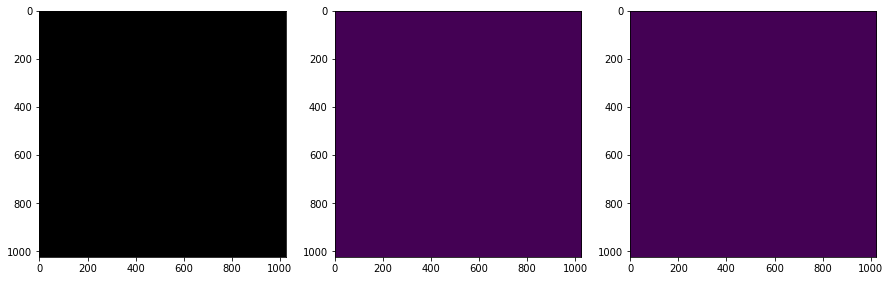

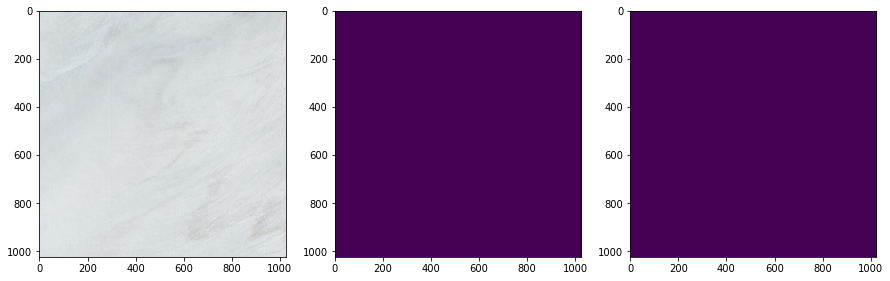

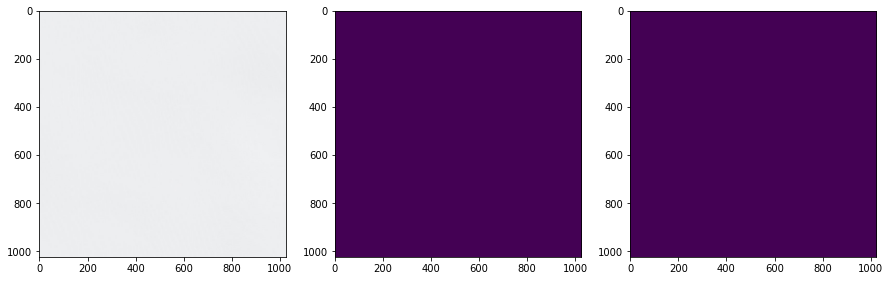

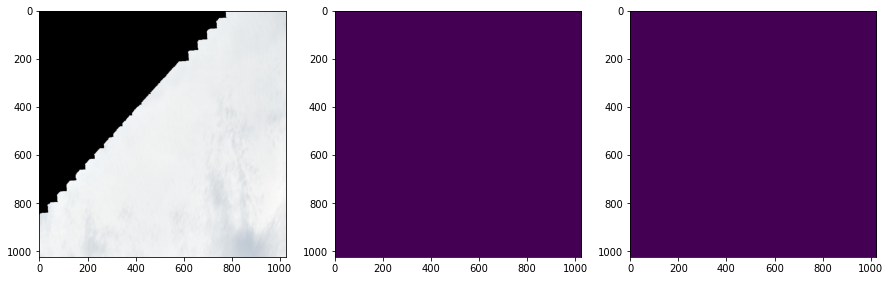

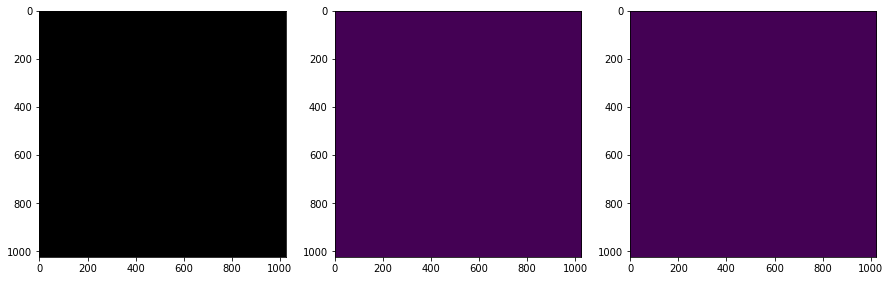

...

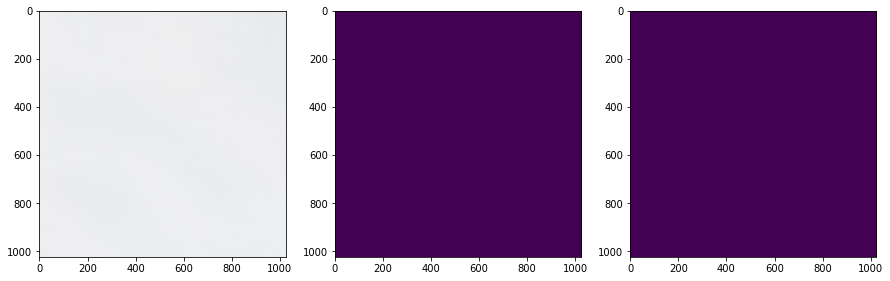

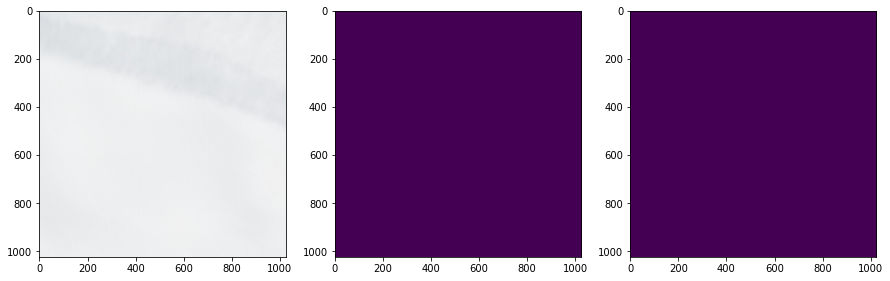

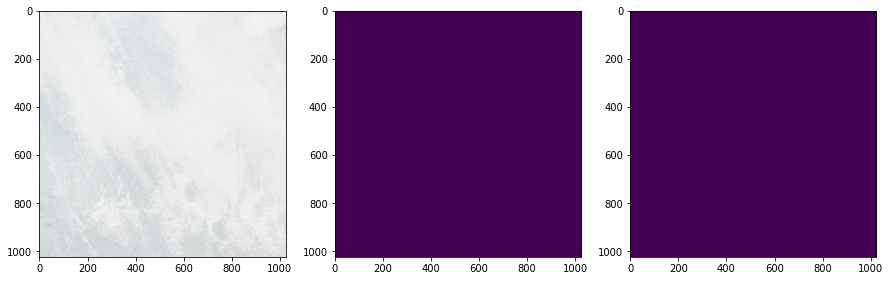

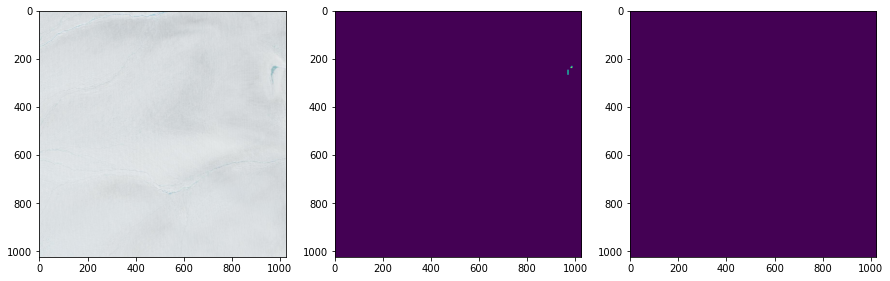

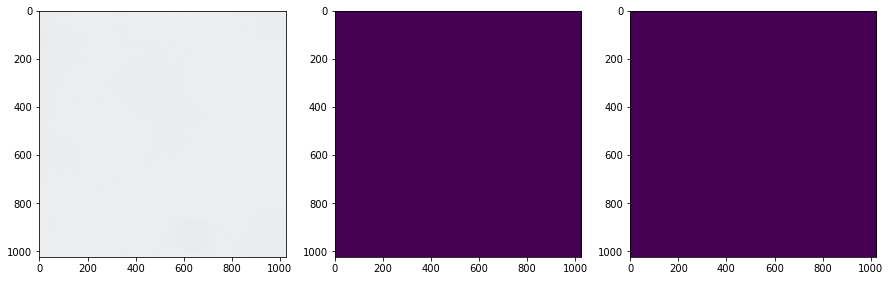

KeyboardInterrupt: 

In [18]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


test_dir = '../data/data_crop1024_shift512/test_images/'
output_dir = '../data/data_crop1024_shift512/test_pred/'
gt_dir = '../data/data_crop1024_shift512/test_mask/'

img_list = os.listdir(test_dir)
target_size = 1024

for img_name in img_list[0:]:
    img_path = os.path.join(test_dir, img_name)
    
    lake_seg = test_model(img_path, model, processor)
    
    upscaled_mask = np.kron(lake_seg, np.ones((target_size // lake_seg.shape[0], target_size// lake_seg.shape[1])))

    # Crop to the target size
    upscaled_mask = upscaled_mask[:target_size, :target_size]

    upscaled_mask = upscaled_mask.astype(np.uint8)

    if SAVE_IMG:
        # Create a Pillow image from the upscaled mask
        upscaled_image = Image.fromarray(upscaled_mask * 255)
        upscaled_image.save(os.path.join(output_dir, img_name))

    else:
        plt.figure(figsize=(15,8))
        
        plt.subplot(1, 3, 1)
        
        image = Image.open(img_path)
        # axes.imshow(image)
        plt.imshow(image)
    
        plt.subplot(1,3,2)
        plt.imshow(upscaled_mask)
        # show_mask(medsam_seg, axes)
    
        gt_path = os.path.join(gt_dir, img_name)
        gt_mask = Image.open(gt_path)
        plt.subplot(1,3,3)
        plt.imshow(gt_mask)
        plt.show()
        # break
    

In [19]:
img_path

'../data/data_crop1024_shift512/test_images/Greenland26X_22W_Sentinel2_2019-08-25_29_r5__h15_w15.jpg'

In [ ]:
0619_r1_h6_w8
r1_h6_w9
